# Montar o Google Drive

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

# this creates a symbolic link so that now the path /content/gdrive/My\ Drive/ is equal to /mydrive
!ln -s /content/gdrive/My\ Drive/ /mydrive
!ls /mydrive

Mounted at /content/gdrive
'Colab Notebooks'   images  'My Drive'	 navios   yolov4


# Clonar e buildar o darknet

In [2]:
%%capture
!git clone https://github.com/AlexeyAB/darknet
%cd darknet
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile
!sed -i 's/CUDNN_HALF=0/CUDNN_HALF=1/' Makefile
!make

# Configurar o YOLOv4

In [27]:
# CFG
!cp /mydrive/navios/navios-test.cfg ./cfg
!cp /mydrive/navios/navios-nfold-test.cfg ./cfg

In [28]:
# obj.names e obj.data
!cp /mydrive/navios/train.names ./data
!cp /mydrive/navios/train.data  ./data

# Funções úteis

In [5]:
# define helper functions
def imShow(path):
  import cv2
  import matplotlib.pyplot as plt
  %matplotlib inline

  image = cv2.imread(path)
  height, width = image.shape[:2]
  resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

  fig = plt.gcf()
  fig.set_size_inches(18, 10)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
  plt.show()

# Teste - Simulador

## 1 fold

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

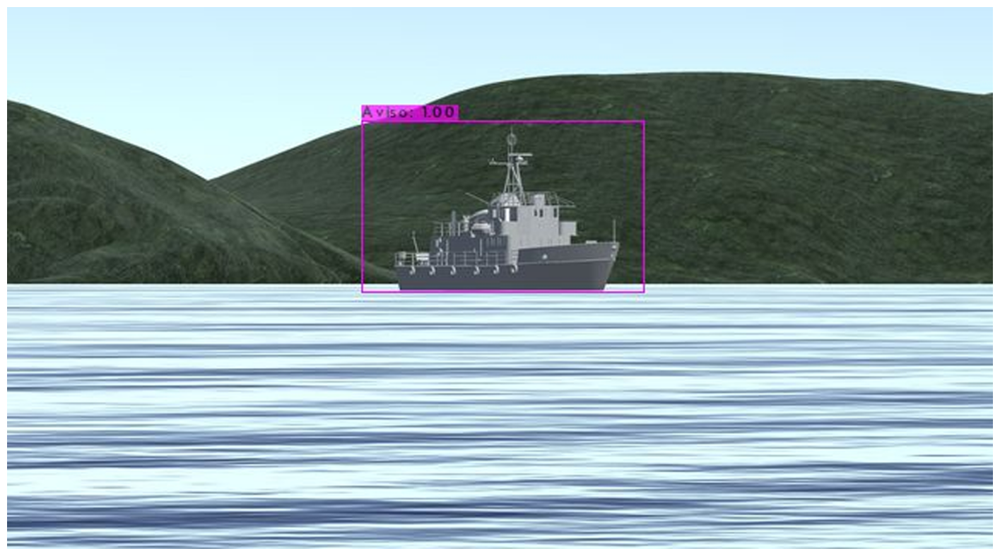

In [70]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-nfold-test.cfg /mydrive/navios/backup_1fold/navios-nfold_best.weights /mydrive/navios/imagens/0_aviso_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

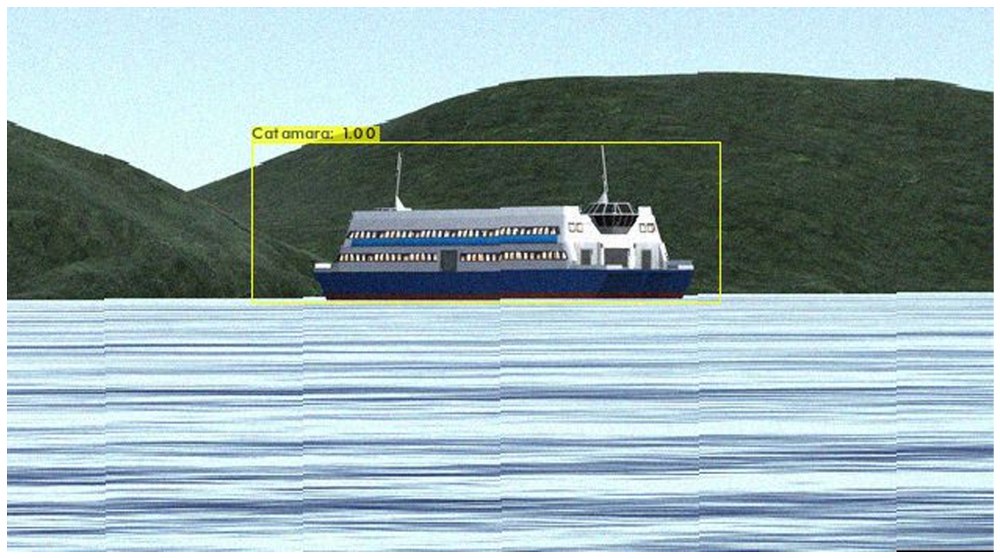

In [69]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/1_catamara_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

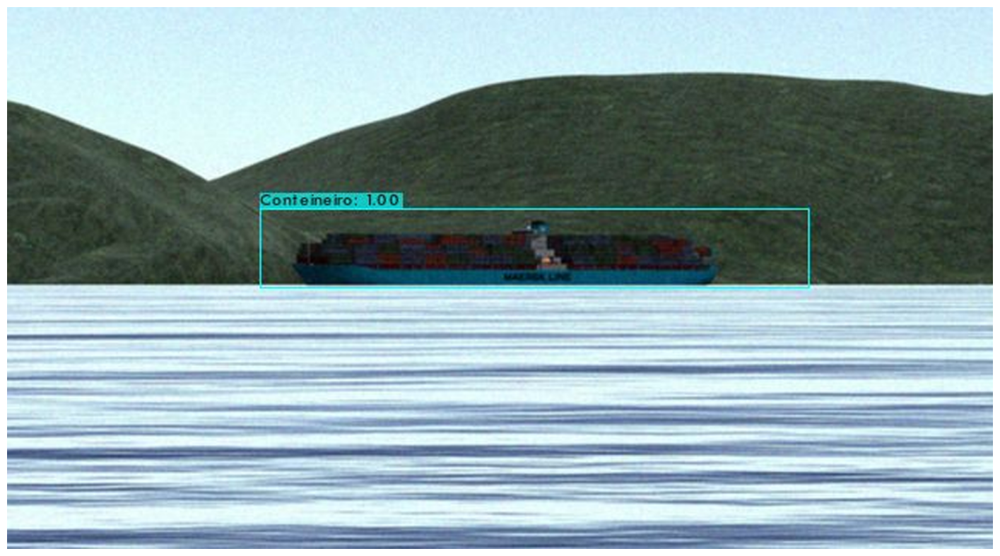

In [51]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/2_conteinero_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

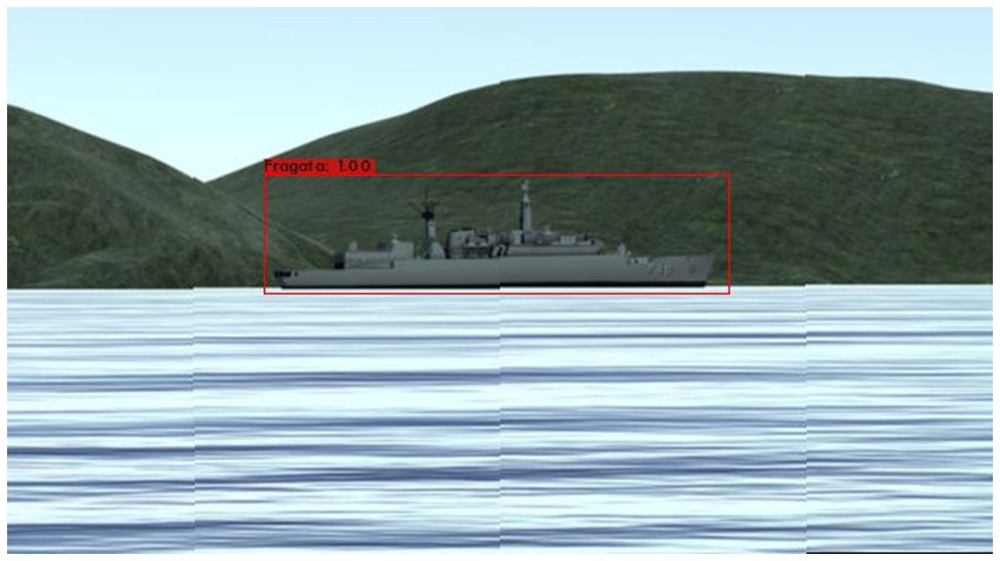

In [52]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/3_fragata_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

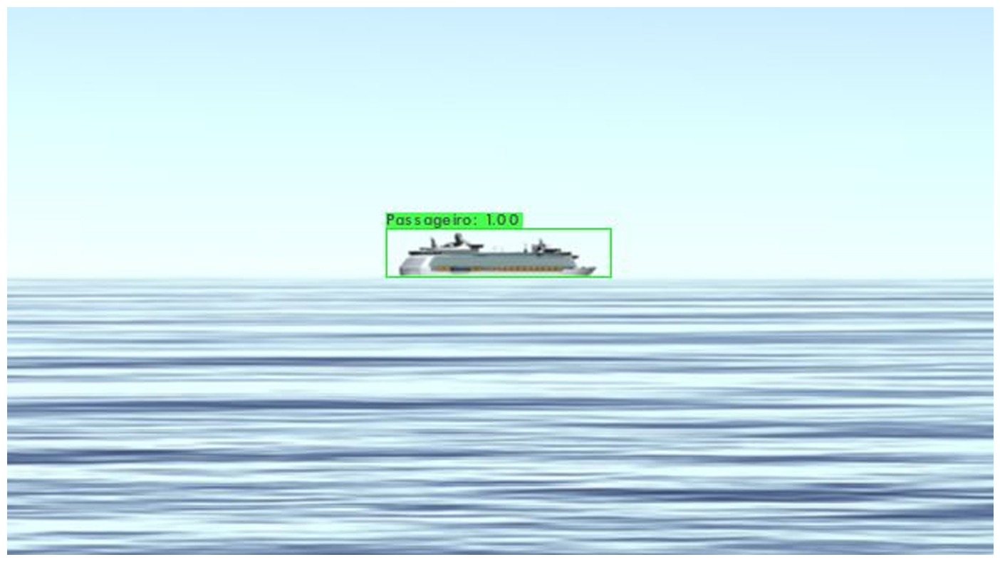

In [53]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/4_passageiro_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

## 5 folds

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

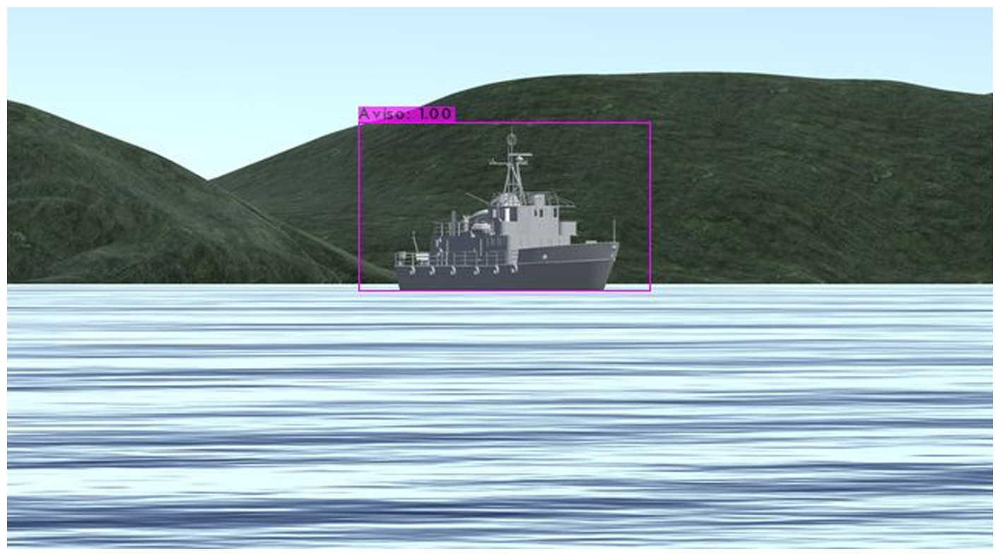

In [54]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/0_aviso_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

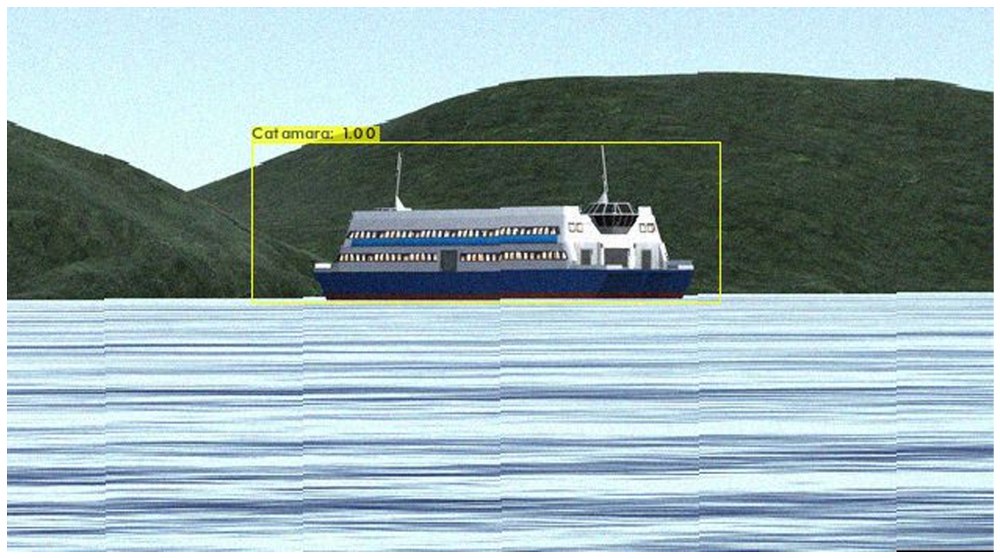

In [55]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/1_catamara_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

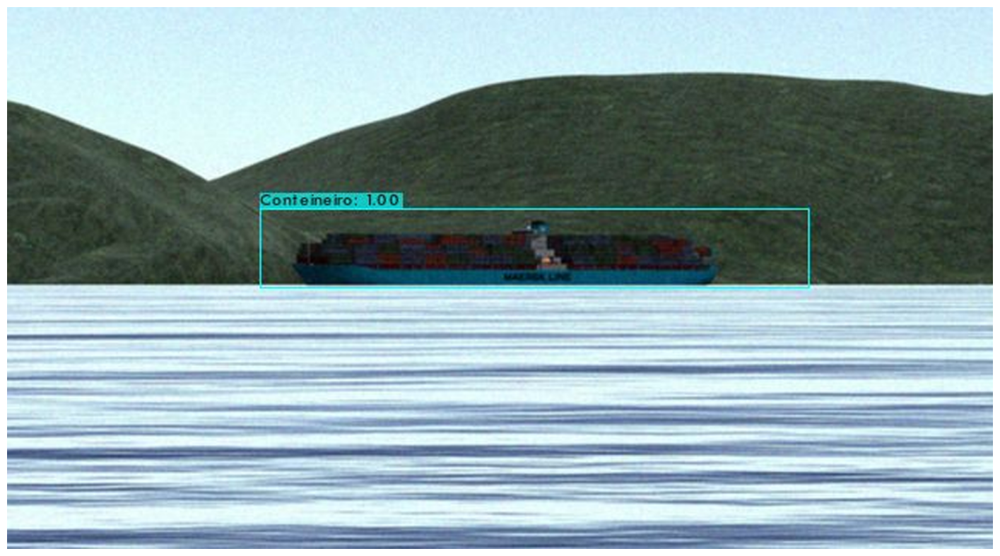

In [56]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/2_conteinero_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

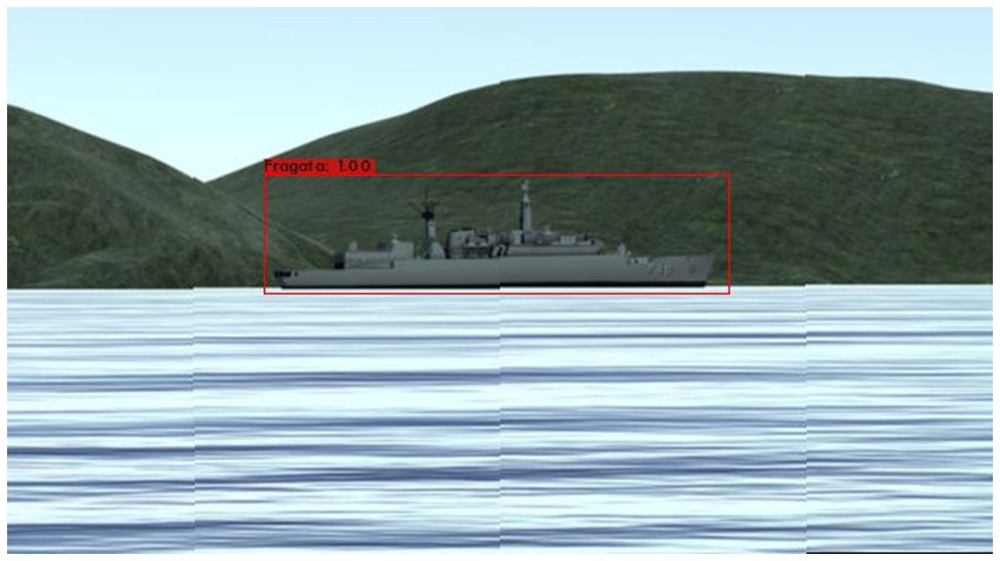

In [57]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/3_fragata_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

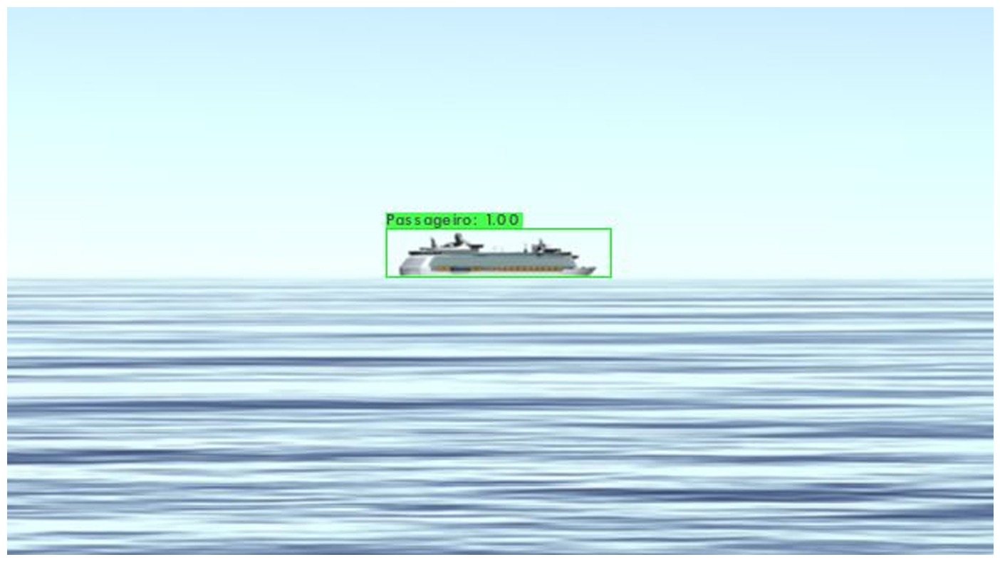

In [58]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/4_passageiro_sim.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

# Teste - Real

# 1 fold

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

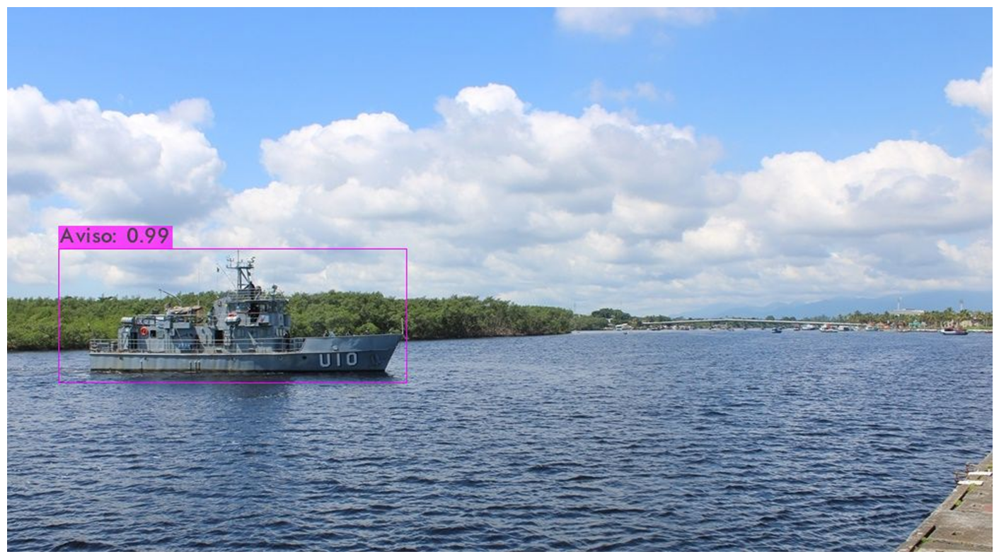

In [94]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-nfold-test.cfg /mydrive/navios/backup_1fold/navios-nfold_best.weights /mydrive/navios/imagens/0_aviso_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

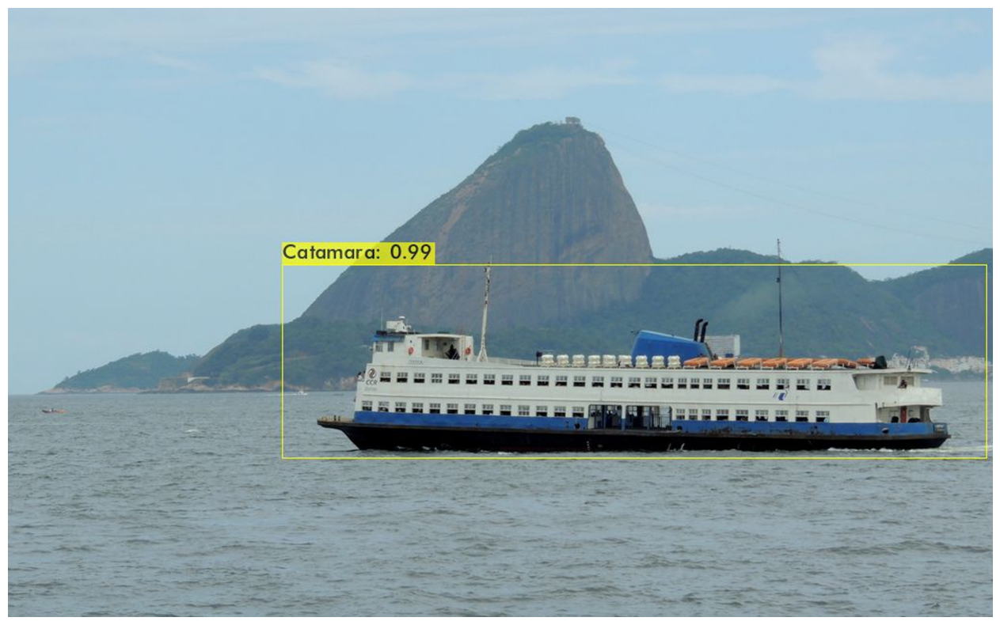

In [95]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-nfold-test.cfg /mydrive/navios/backup_1fold/navios-nfold_best.weights /mydrive/navios/imagens/1_catamara_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

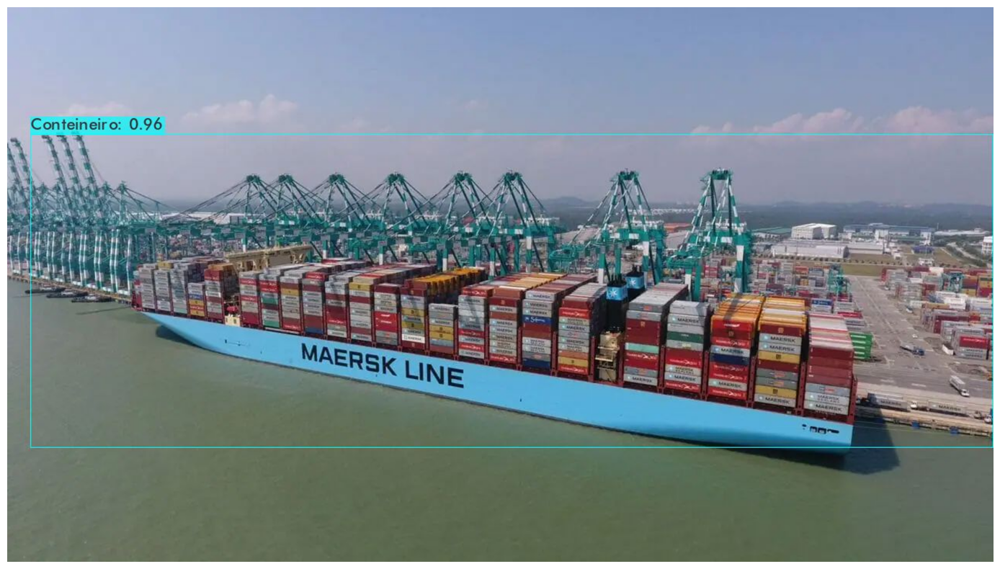

In [96]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-nfold-test.cfg /mydrive/navios/backup_1fold/navios-nfold_best.weights /mydrive/navios/imagens/2_conteinero_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

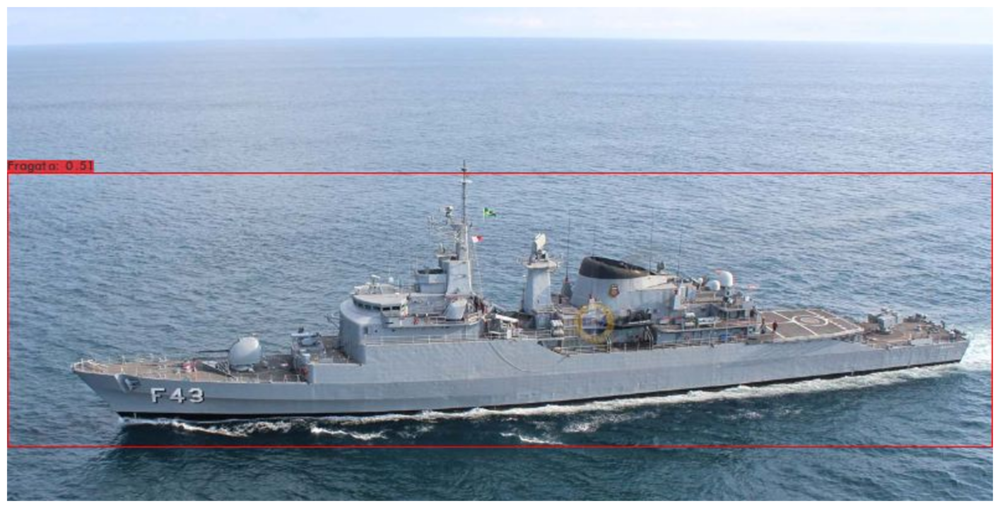

In [100]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-nfold-test.cfg /mydrive/navios/backup_1fold/navios-nfold_best.weights /mydrive/navios/imagens/3_fragata_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

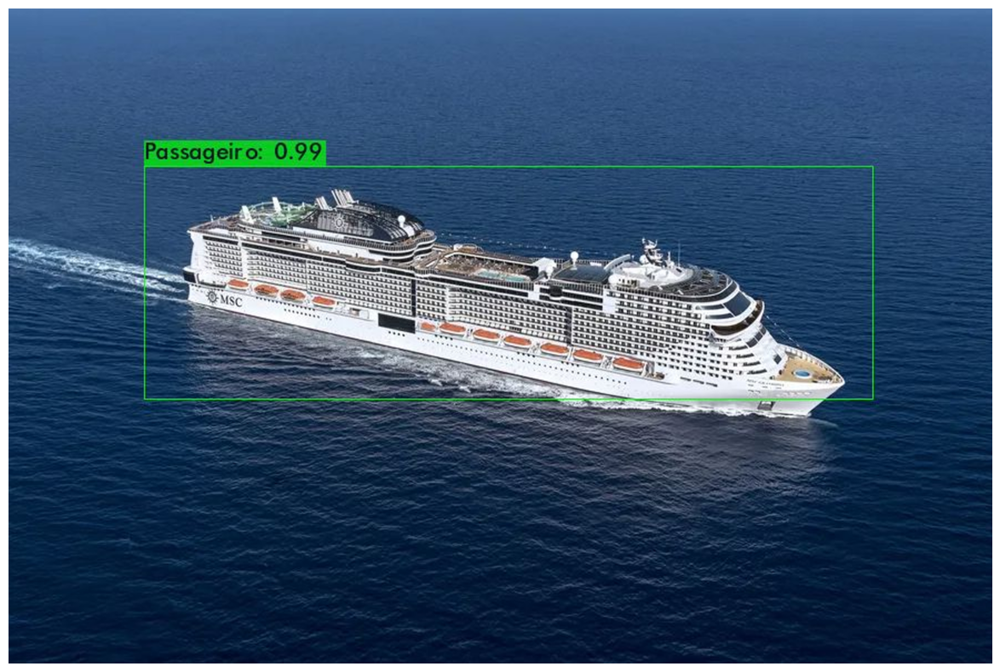

In [98]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-nfold-test.cfg /mydrive/navios/backup_1fold/navios-nfold_best.weights /mydrive/navios/imagens/4_passageiro_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

## 5 folds

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

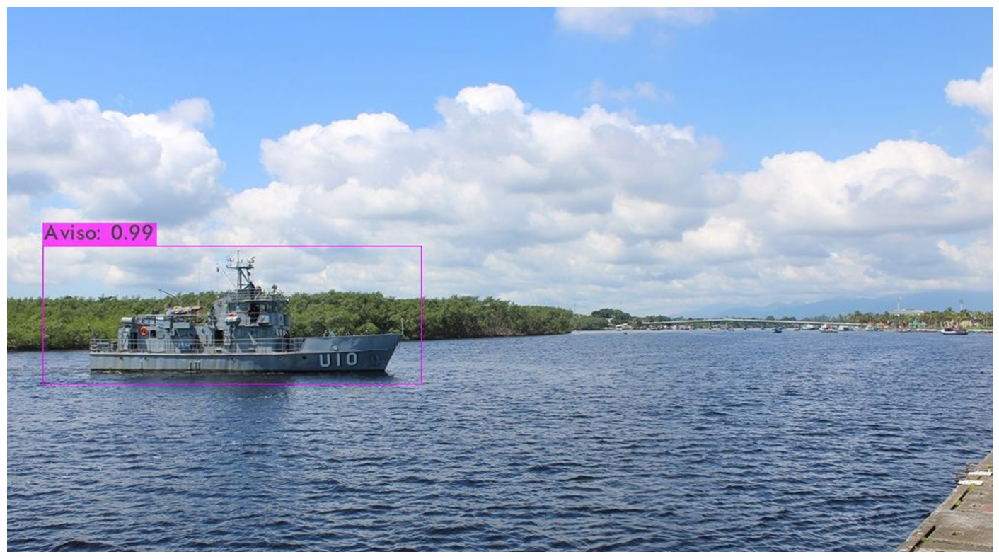

In [75]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/0_aviso_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

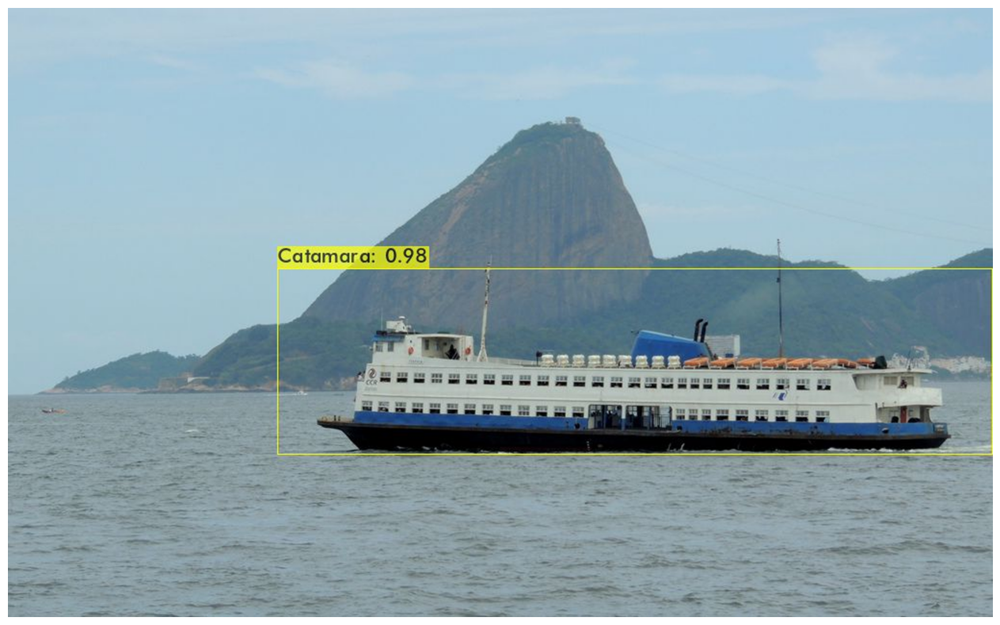

In [83]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/1_catamara_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

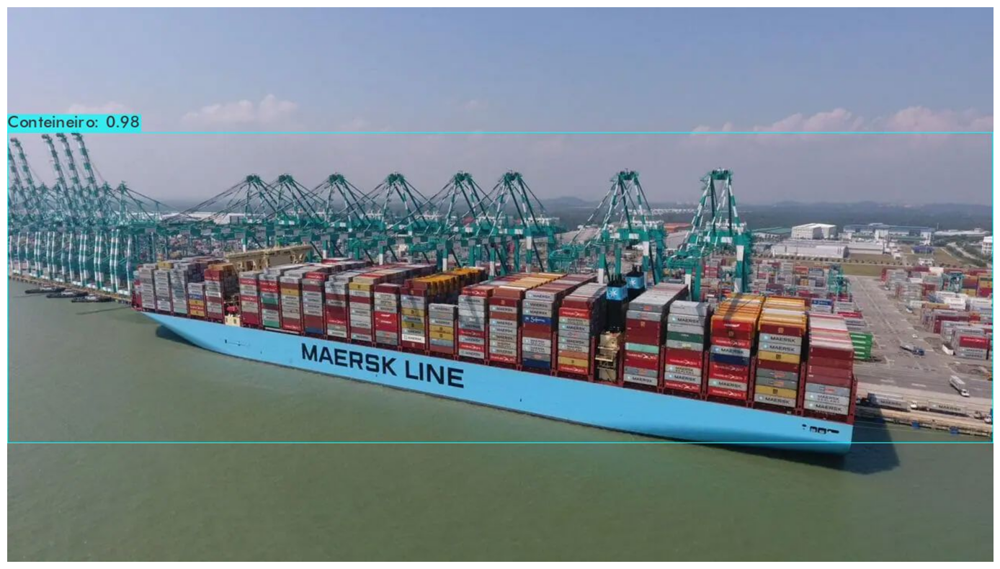

In [85]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/2_conteinero_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

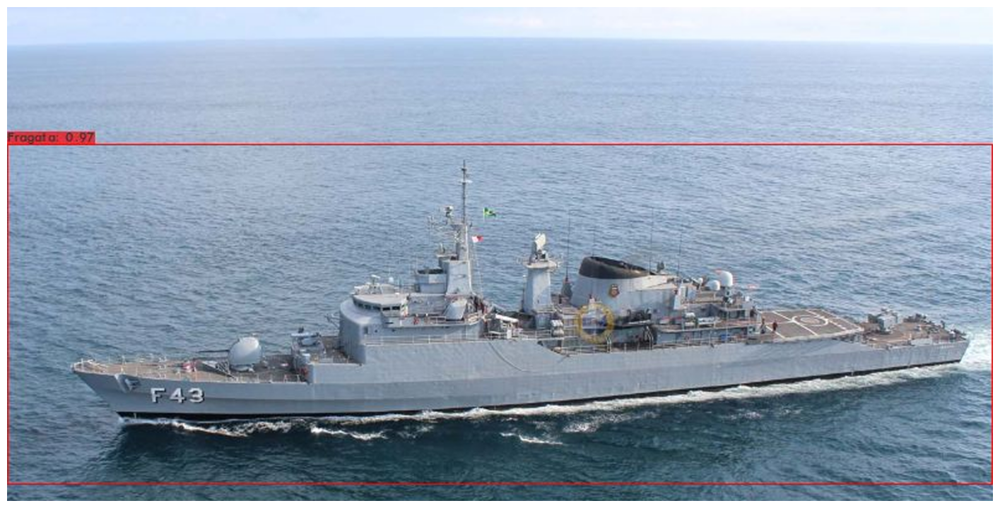

In [99]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/3_fragata_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')

 CUDA-version: 12020 (12020), cuDNN: 8.9.6, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 4.5.4
 0 : compute_capability = 800, cudnn_half = 1, GPU: NVIDIA A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    640 x 352 x   3 ->  640 x 352 x  32 0.389 BF
   1 conv     64       3 x 3/ 2    640 x 352 x  32 ->  320 x 176 x  64 2.076 BF
   2 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   3 route  1 		                           ->  320 x 176 x  64 
   4 conv     64       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  64 0.461 BF
   5 conv     32       1 x 1/ 1    320 x 176 x  64 ->  320 x 176 x  32 0.231 BF
   6 conv     64       3 x 3/ 1    320 x 176 x  32 ->  320 x 176 x  64 2.076 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 320 x 176 x  64 0.004 BF

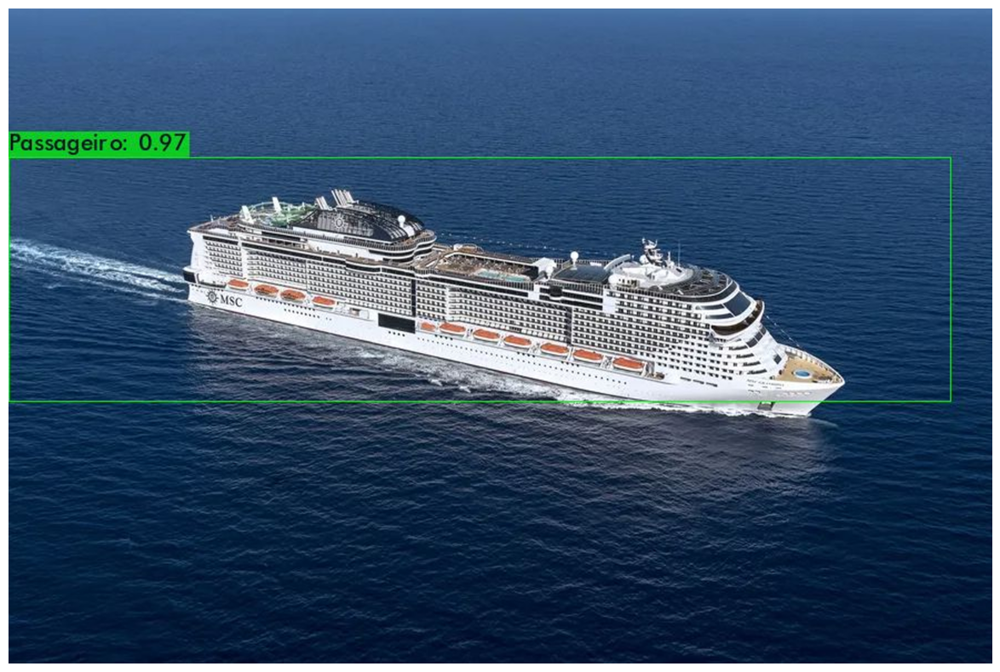

In [68]:
# carregar os melhores pesos e testar
!./darknet detector test data/train.data cfg/navios-test.cfg /mydrive/navios/backup_train/navios-train_best.weights /mydrive/navios/imagens/4_passageiro_real.png -thresh 0.3 -dont_show
# plotar
imShow('predictions.jpg')